# Point Clouds

We cover in this tutorial how to solve an {term}`entropy-regularized optimal transport` problem between two point clouds by instantiating a {class}`~ott.geometry.pointcloud.PointCloud` geometry.

In [1]:
import jax
import jax.numpy as jnp

import matplotlib.pyplot as plt
from IPython import display

import ott
from ott.geometry import costs, pointcloud
from ott.solvers import linear

## Create a {class}`~ott.geometry.pointcloud.PointCloud`

In [2]:
def create_points(rng: jax.Array, n: int, m: int, d: int):
    rngs = jax.random.split(rng, 3)
    x = jax.random.normal(rngs[0], (n, d)) + 1
    y = jax.random.uniform(rngs[1], (m, d))
    return x, y


rng = jax.random.key(0)
n, m, d = 13, 17, 2
x, y = create_points(rng, n=n, m=m, d=d)
geom = pointcloud.PointCloud(x, y)

## Compute the entropy regularized optimal transport

To compute the transport matrix solving the {term}`entropy-regularized optimal transport` problem between two point clouds, one defines first a {class}`~ott.geometry.pointcloud.PointCloud` geometry.

A {class}`~ott.geometry.pointcloud.PointCloud` geometry holds two arrays of vectors (the supports of the two measures of interest), along with a {term}`ground cost` function (a {class}`~ott.geometry.costs.CostFn` object, set by default to {class}`~ott.geometry.costs.SqEuclidean`) and, possibly an {class}`~ott.geometry.epsilon_scheduler.Epsilon` regularization parameter.

This geometry object defines a {class}`~ott.problems.linear.linear_problem.LinearProblem` object, which contains all the data needed to instantiate a linear OT problem (see the {doc}`../quadratic/000_gromov_wasserstein` tutorial for *quadratic* OT problems).

We can then call a {class}`~ott.solvers.linear.sinkhorn.Sinkhorn` solver to solve that problem, and compute the OT between these points clouds. Note that all weights are assumed to be uniform in this notebook, but non-uniform weights can be passed as `a=..., b=...` arguments when defining the {class}`~ott.problems.linear.linear_problem.LinearProblem` below.

In [3]:
ot = linear.solve(geom)
# The out object contains many things, among which the regularized OT cost
print(
    " Sinkhorn has converged: ",
    ot.converged,
    "\n",
    "Error upon last iteration: ",
    ot.errors[(ot.errors > -1)][-1],
    "\n",
    "Sinkhorn required ",
    jnp.sum(ot.errors > -1),
    " iterations to converge. \n",
    "Entropy regularized OT cost: ",
    ot.ent_reg_cost,
    "\n",
    "OT cost (without entropy): ",
    jnp.sum(ot.matrix * ot.geom.cost_matrix),
)

 Sinkhorn has converged:  True 
 Error upon last iteration:  0.0004093051 
 Sinkhorn required  5  iterations to converge. 
 Entropy regularized OT cost:  1.6026988 
 OT cost (without entropy):  2.1144307


The `ot` object contains several functions and properties, notably a simple way to instantiate, if needed, the OT matrix.

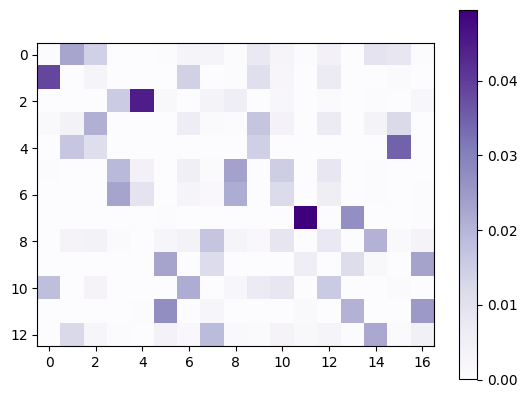

In [4]:
# you can instantiate the OT matrix
P = ot.matrix
plt.imshow(P, cmap="Purples")
plt.colorbar();

You can also instantiate a `plott` object to help visualize the transport in 2-dimensions.

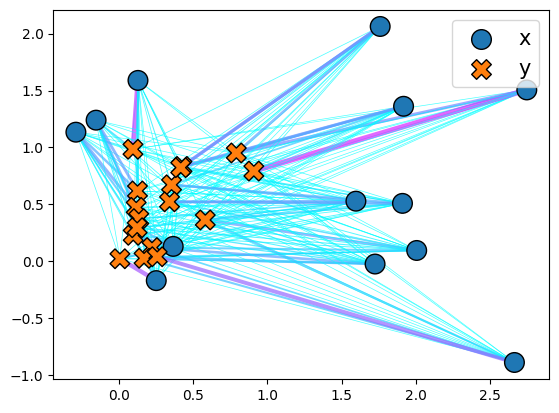

In [5]:
plott = ott.tools.plot.Plot()
_ = plott(ot)

## OT gradient flows

OTT returns quantities that are differentiable. In the following example, we leverage the gradients to move $n$ points in a way that minimizes the overall regularized OT cost, given a ground cost function. 

We start by defining a minimal optimization loop, that does fixed-length gradient descent, and records various `ot` objects along the way for plotting. By choosing various cost functions, we can then plot different types of gradient flows for the point cloud in $x$. See also the {doc}`../linear/200_sinkhorn_divergence_gradient_flow` tutorial.

In [6]:
def optimize(
    x: jnp.ndarray,
    y: jnp.ndarray,
    num_iter: int = 300,
    dump_every: int = 5,
    learning_rate: float = 0.2,
    **kwargs,  # passed to the pointcloud.PointCloud geometry
):
    # Wrapper function that returns OT cost and OT output given a geometry.
    def reg_ot_cost(geom):
        out = linear.solve(geom)
        return out.reg_ot_cost, out

    # Apply jax.value_and_grad operator. Note that we make explicit that
    # we only wish to compute gradients w.r.t the first output,
    # using the has_aux flag. We also jit that function.
    reg_ot_cost_vg = jax.jit(jax.value_and_grad(reg_ot_cost, has_aux=True))

    # Run a naive, fixed stepsize, gradient descent on locations `x`.
    ots = []
    titles = []
    for i in range(0, num_iter + 1):
        geom = pointcloud.PointCloud(x, y, **kwargs)
        (reg_ot_cost, ot), geom_g = reg_ot_cost_vg(geom)
        assert ot.converged
        x = x - geom_g.x * learning_rate
        if i % dump_every == 0:
            ots.append(ot)
            titles.append(f"Iter {i}: Reg OT Cost: {reg_ot_cost}")
    return ots, titles

In [7]:
# Helper function to plot successively the optimal transports


def plot_ots(ots, titles):
    fig = plt.figure(figsize=(8, 5))
    plott = ott.tools.plot.Plot(fig=fig)
    anim = plott.animate(ots, frame_rate=4, titles=titles)
    html = display.HTML(anim.to_jshtml())
    display.display(html)
    plt.close()

$W_2^2$ Gradient Flow


In [8]:
plot_ots(
    *optimize(
        x,
        y,
        num_iter=100,
        epsilon=1e-2,
        cost_fn=costs.SqEuclidean(),
    )
)

$W_1$ Gradient Flow

In [9]:
plot_ots(*optimize(x, y, num_iter=250, epsilon=1e-2, cost_fn=costs.Euclidean()))

$W_{1/2}$ Gradient Flow

In [10]:
@jax.tree_util.register_pytree_node_class
class Custom(costs.TICost):
    """Custom, translation invariant cost, sqrt of Euclidean norm."""

    def h(self, z):
        return jnp.sqrt(jnp.abs(jnp.linalg.norm(z)))


plot_ots(*optimize(x, y, num_iter=400, epsilon=1e-2, cost_fn=Custom()))

$W_{\text{cosine}}$ Gradient Flow

In [11]:
plot_ots(*optimize(x, y, num_iter=400, epsilon=1e-2, cost_fn=costs.Cosine()))

$W_{\text{1.5}^2}$ Gradient Flow

In [12]:
plot_ots(
    *optimize(x, y, num_iter=300, epsilon=1e-2, cost_fn=costs.SqPNorm(p=1.5))
)

## Transport map using Sinkhorn potentials

We show next how to instantiate easily a {term}`transport map` from the output of the {class}`~ott.solvers.linear.sinkhorn.Sinkhorn` algorithm. This is done using the {class}`~ott.problems.linear.potentials.EntropicPotentials` {cite}`pooladian:21` which can be constructed from the approximate {term}`dual Kantorovich potentials` $f$ and $g$ returned by the {term}`Sinkhorn algorithm`.

In [13]:
# Plotting utility


def plot_map(x, y, znew, tznew, forward: bool = True):
    plt.figure(figsize=(10, 8))
    if forward:
        label = r"$x_{\text{new}}$"
        tlabel = r"$T_{x\rightarrow y}(x_{\text{new}})$"
        marker_t = "X"
        marker_n = "o"
    else:
        label = r"$y_{\text{new}}$"
        tlabel = r"$T_{y\rightarrow x}(y_{\text{new}})$"
        marker_t = "o"
        marker_n = "X"

    plt.quiver(
        *znew.T,
        *(tznew - znew).T,
        color="k",
        angles="xy",
        scale_units="xy",
        scale=1,
        width=0.007,
    )
    plt.scatter(*x.T, s=200, edgecolors="k", marker="o", label=r"$x$")
    plt.scatter(*y.T, s=200, edgecolors="k", marker="X", label=r"$y$")
    plt.scatter(*znew.T, s=200, edgecolors="k", marker=marker_n, label=label)
    plt.scatter(*tznew.T, s=150, edgecolors="k", marker=marker_t, label=tlabel)
    plt.legend(fontsize=22)

We first run the {class}`~ott.solvers.linear.sinkhorn.Sinkhorn` algorithm with the standard {class}`~ott.geometry.costs.SqEuclidean`, and turn its output to a {class}`~ott.problems.linear.potentials.EntropicPotentials` object.

In [14]:
geom = pointcloud.PointCloud(x, y)
out = linear.solve(geom)
dual_potentials = out.to_dual_potentials()

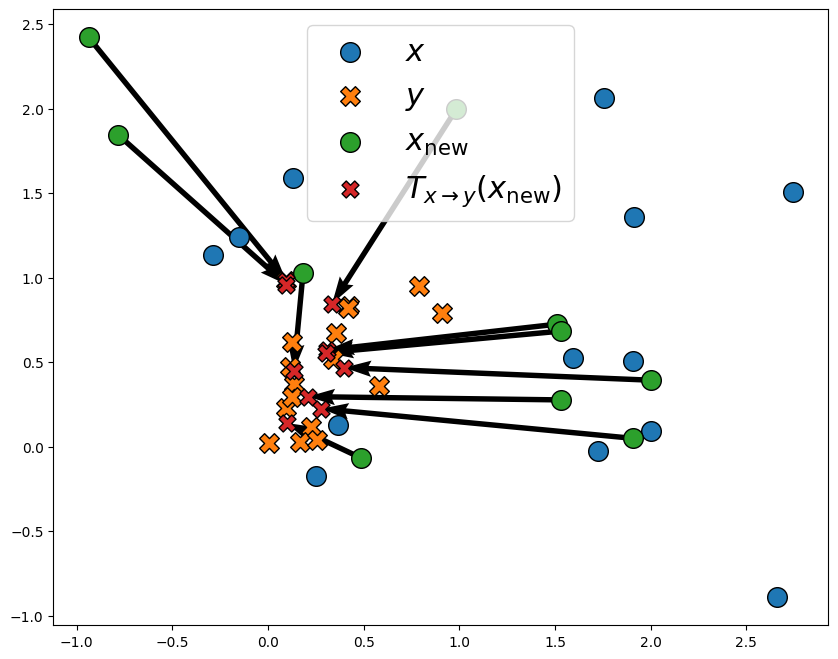

In [15]:
xnew, ynew = create_points(jax.random.key(1), 10, 10, d)

plot_map(x, y, xnew, dual_potentials.transport(xnew))

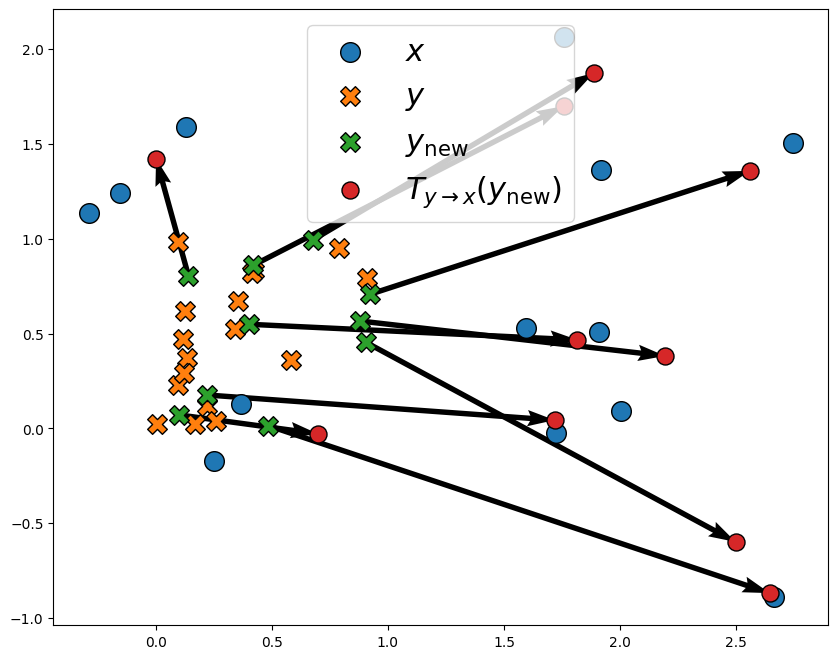

In [16]:
plot_map(
    x, y, ynew, dual_potentials.transport(ynew, forward=False), forward=False
)